In [ ]:
!wget https://github.com/cloudflare/cloudflared/releases/latest/download/cloudflared-linux-amd64.deb
!dpkg -i cloudflared-linux-amd64.deb

In [ ]:
import gradio as gr
from diffusers import StableDiffusionPipeline, StableDiffusionXLPipeline, DPMSolverMultistepScheduler
import torch

def generate_image(prompt, model_choice, cfg_scale, image_size):
    if torch.cuda.is_available():
        device = "cuda"
        dtype = torch.float16
    else:
        device = "cpu"
        dtype = torch.float32

    # Determine model based on user selection
    if model_choice == "1.5SD":
        model_id = "runwayml/stable-diffusion-v1-5"
        pipe = StableDiffusionPipeline.from_pretrained(model_id, torch_dtype=dtype)
    else:
        model_id = "stabilityai/stable-diffusion-xl-base-1.0"
        pipe = StableDiffusionXLPipeline.from_pretrained(model_id, torch_dtype=dtype)

    pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)

    pipe.to(device)

    # Set image dimensions
    width, height = map(int, image_size.split('x'))

    # Generate image

    image = pipe(
        prompt=prompt,
        guidance_scale=cfg_scale,
        width=width,
        height=height,
        num_inference_steps=50
    ).images[0]

    return image

# Create Gradio interface
with gr.Blocks(title="Stable Diffusion Image Generator") as demo:
    gr.Markdown("# Stable Diffusion Image Generator by Mahdi Savoji")
    gr.Markdown("Enter your prompt and adjust the settings below.")

    with gr.Row():
        with gr.Column():
            prompt = gr.Textbox(label="Prompt", placeholder="A beautiful mountain landscape...")
            model_choice = gr.Radio(
                choices=["1.5SD", "SDXL"],
                label="Model Selection",
                value="SDXL"
            )
            cfg_scale = gr.Slider(
                minimum=1.0,
                maximum=20.0,
                value=7.5,
                step=0.5,
                label="CFG Scale (Guidance Scale)"
            )
            image_size = gr.Radio(
                choices=["16x16", "64x64", "128x128", "256x256", "512x512", "768x768", "1024x1024"],
                label="Image Size",
                value="1024x1024"
            )
            generate_btn = gr.Button("Generate Image")

        with gr.Column():
            output_image = gr.Image(label="Generated Image")

    # Connect button to generation function
    generate_btn.click(
        fn=generate_image,
        inputs=[prompt, model_choice, cfg_scale, image_size],
        outputs=output_image
    )

# Launch the application
if __name__ == "__main__":
    demo.launch(share=True,debug=True)

Colab notebook detected. This cell will run indefinitely so that you can see errors and logs. To turn off, set debug=False in launch().
* Running on public URL: https://585b026b2bbfba3fab.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 19 files:   0%|          | 0/19 [00:00<?, ?it/s]

scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

text_encoder_2/model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

config.json: 0.00B [00:00, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/10.3G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

vae_1_0/diffusion_pytorch_model.safetens(…):   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Keyboard interruption in main thread... closing server.
Killing tunnel 127.0.0.1:7860 <> https://585b026b2bbfba3fab.gradio.live


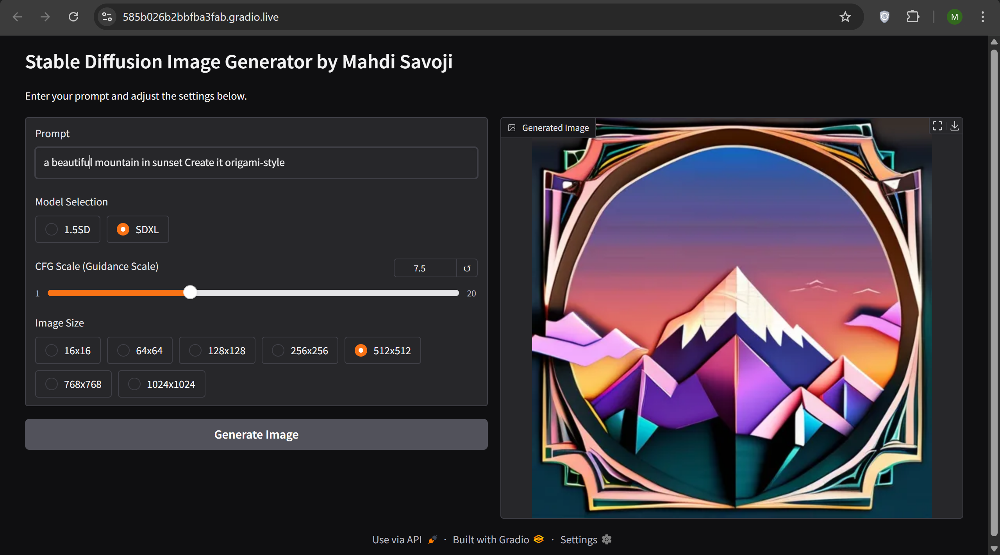

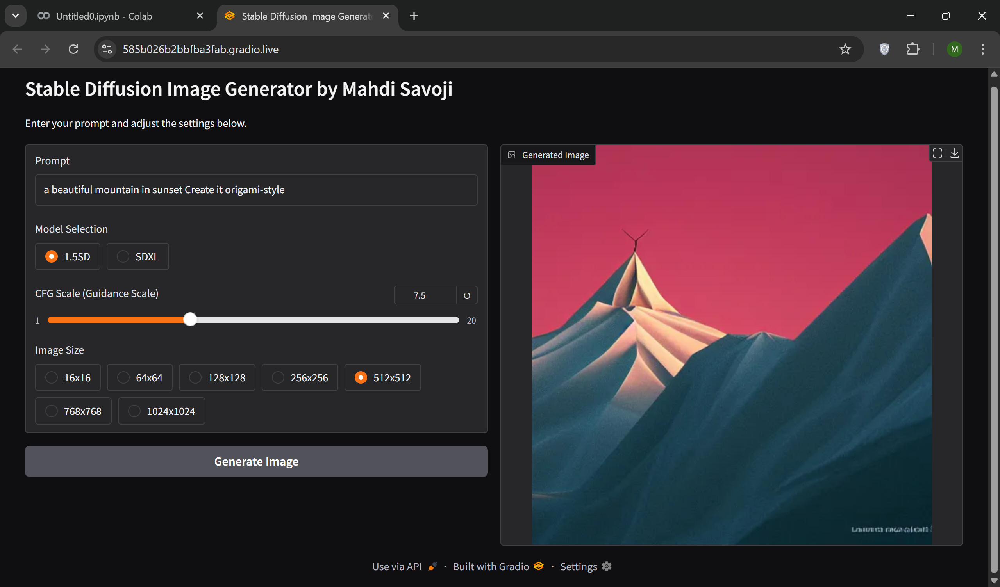

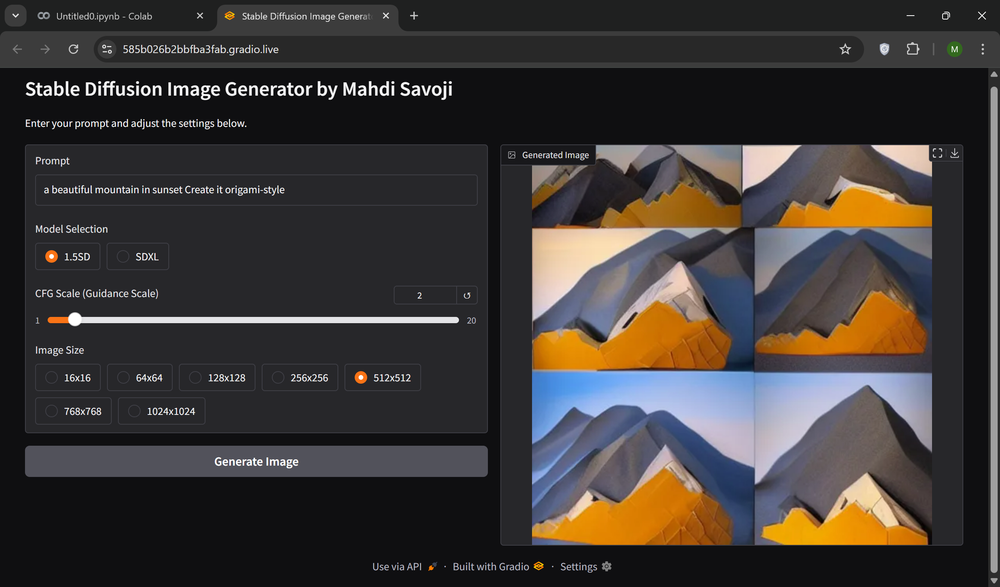

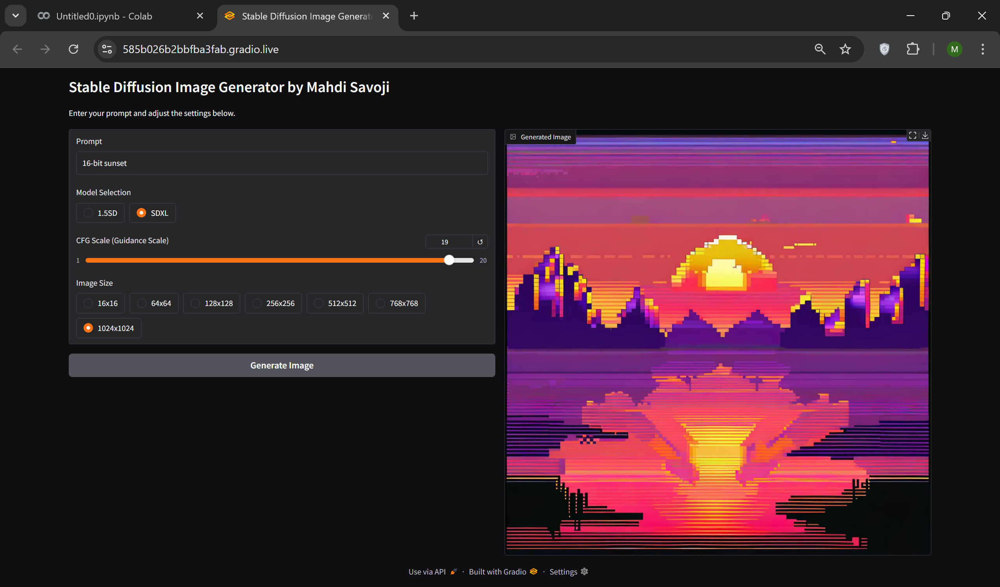

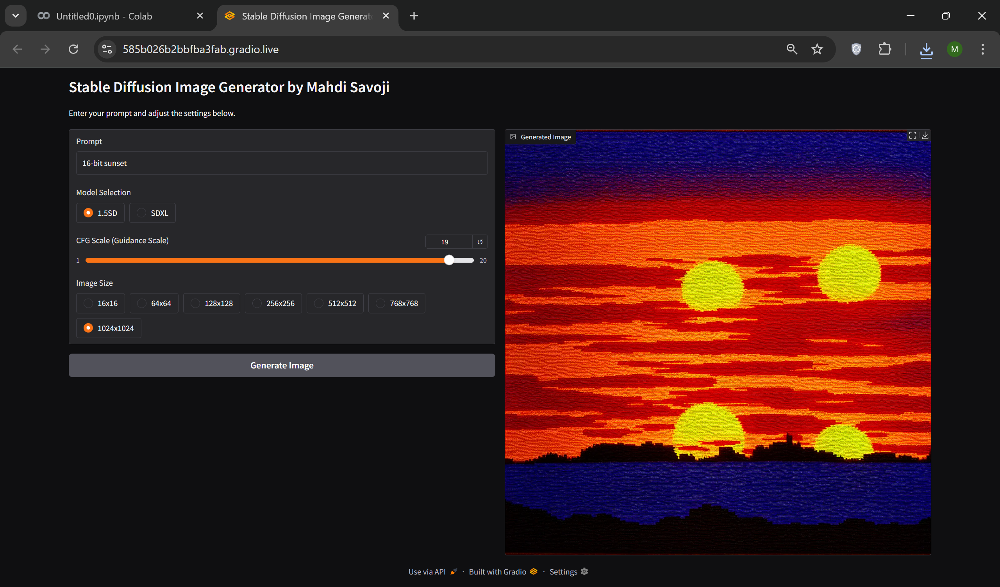

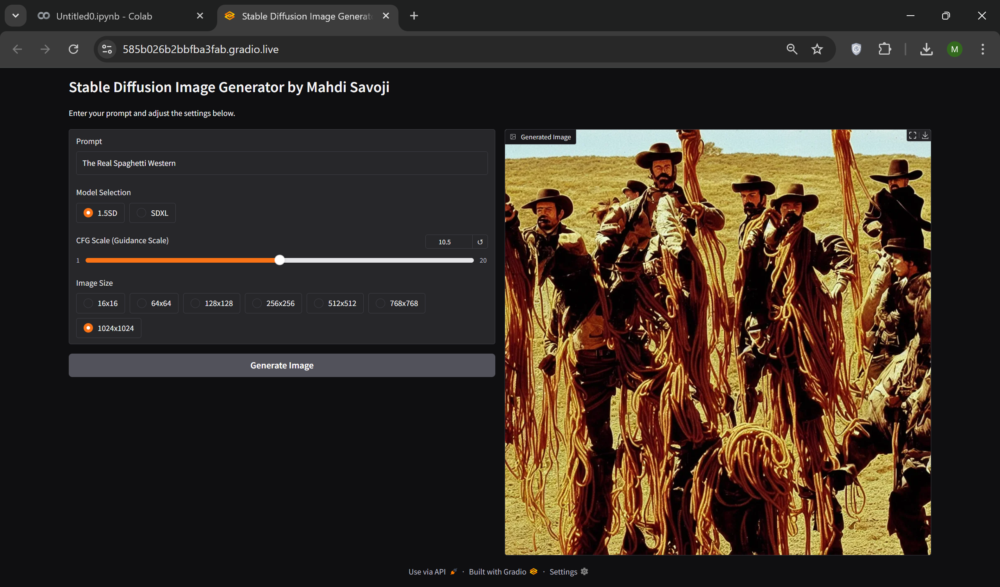

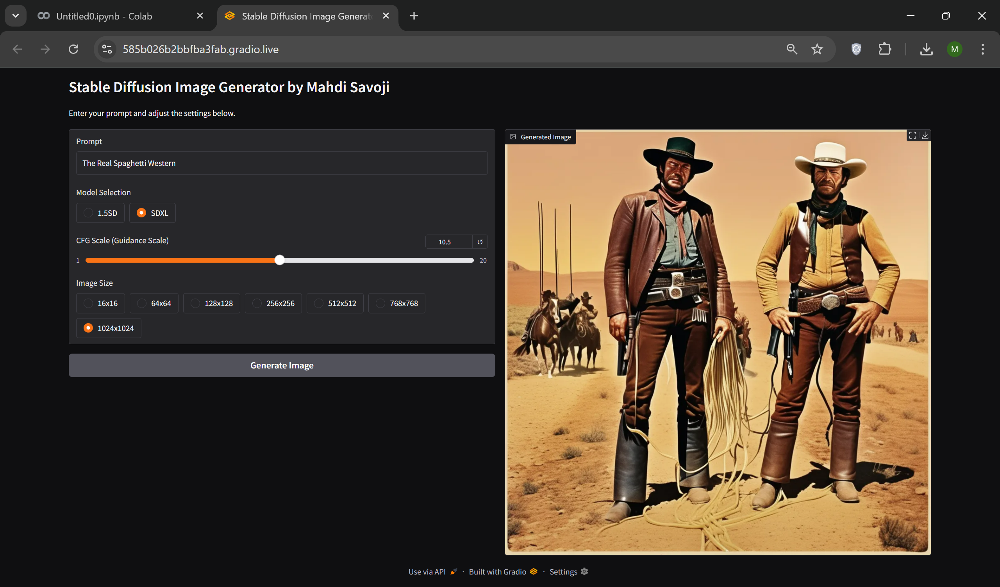

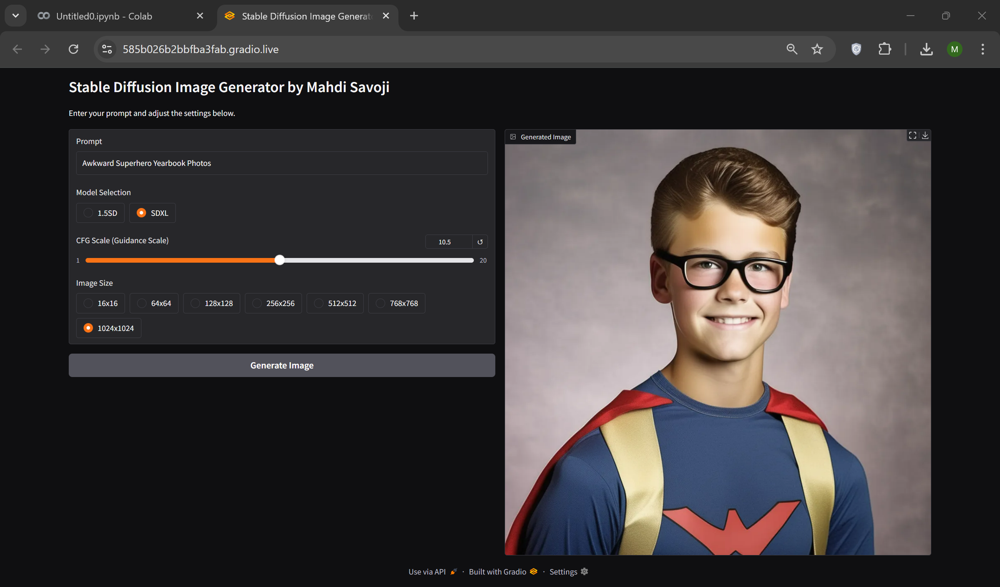

In [1]:
from IPython.display import display, Image
from PIL import Image as PILImage

# List of image paths
image_paths = [
    "Output/1.png",
    "Output/2.png",
    "Output/3.png",
    "Output/4.png",
    "Output/5.png",
    "Output/6.png",
    "Output/7.png",
    "Output/8.png"
]

# Display each image in a new row
for img_path in image_paths:
    display(PILImage.open(img_path))